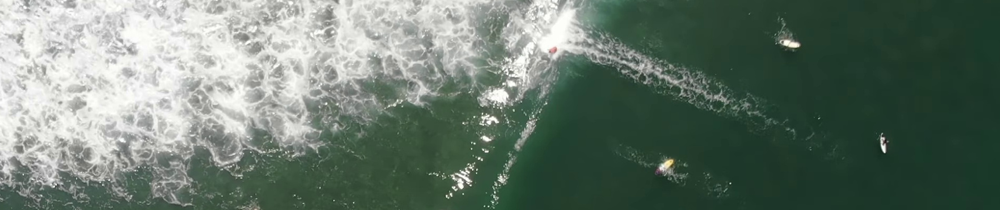

**AFO - Aerial dataset of floating objects**

Aerial dataset for maritime Search and Rescue applications.

AFO dataset is the first free dataset for training machine learning and deep learning models for maritime Search and Rescue applications. It contains aerial-drone videos with 40,000 hand-annotated persons and objects floating in the water, many of small size, which makes them difficult to detect.

The AFO dataset contains images taken from fifty video clips containing objects floating on the water surface, captured by the various drone-mounted cameras (from 1280x720 to 3840x2160 resolutions), which have been used to create AFO. From these videos, we have extracted and manually annotated 3647 images that contain 39991 objects.These have been then split into three parts: the training (67,4% of objects), the test (19,12% of objects), and the validation set (13,48% of objects). In order to prevent overfitting of the model to the given data, the test set contains selected frames from nine videos that were not used in either the training or validation sets.


**Citation, BibteX:**

@article{article,

author = {Gąsienica-Józkowy, Jan and Knapik, Mateusz and Cyganek, Boguslaw},

year = {2021},

month = {01},

pages = {1-15},

title = {An ensemble deep learning method with optimized weights for drone-based water rescue and surveillance},

journal = {Integrated Computer-Aided Engineering},

doi = {10.3233/ICA-210649}

}

**Acknowledgements**

This work was supported by the Polish National Science Center under grant no. 2016/21/B/ST6/01461. We would also like to express our thanks to Agnieszka Malonik Taggart, Wojciech Sulewski, Dariusz Nawrocki, and Wojciech Kubiela - photographs who decided to support our project by sending us videos for the AFO dataset.

**License:**

The datasets provided on this page are published under the Creative Commons Attribution-NonCommercial-ShareAlike 3.0 License.

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

**Importing Modules**

In [51]:
import numpy as np
import pandas as pd
import cv2
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
import os
import glob
import shutil
from pathlib import Path
from shapely.geometry import Polygon, Point
import math
import torch
import matplotlib.patches as patches

**Data Paths**

In [3]:
#Set up our img paths 
part_1 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/images'
part_2 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_2/PART_2/images'
part_3 = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_3/PART_3/images'
# Annotation paths
annotation_path = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/6categories'

In [4]:
root_img_path = Path('/kaggle/working/Dataset/images')
root_ann_path = Path('/kaggle/working/Dataset/annotations')

if not root_img_path.exists():
        print(f"Path {root_img_path} does not exit")
        os.makedirs(root_img_path)
        
if not root_ann_path.exists():
        print(f"Path {root_ann_path} does not exit")
        os.makedirs(root_ann_path)

Path /kaggle/working/Dataset/images does not exit
Path /kaggle/working/Dataset/annotations does not exit


In [5]:
# Copy files from our img paths to our image folder in our working directory
def copy_files(src, dest):
    files = os.listdir(src)
    for file in files:
        shutil.copy2(os.path.join(src,file), dest)
        
copy_files(part_1, root_img_path)
copy_files(part_2, root_img_path)
copy_files(part_3, root_img_path)
copy_files(annotation_path, root_ann_path)

**EDA & Visualizations**

3641
(2720, 1530)


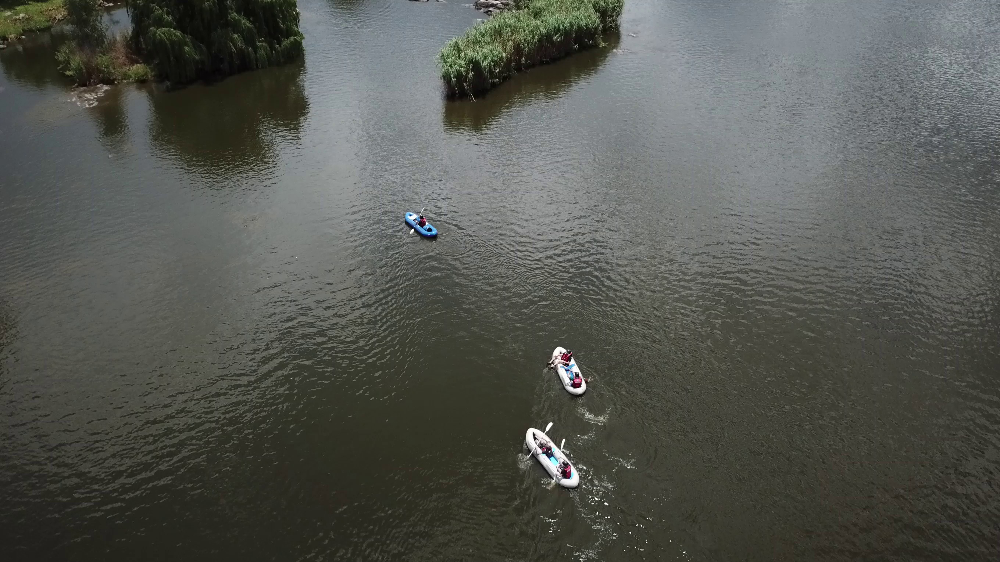

In [6]:
images_path = '/kaggle/working/Dataset/images'
images_list = glob.glob(os.path.join(images_path , "*.jpg"))
print(len(images_list))
#visualise a single image
# img = cv2.imread(images_list[0])
# plt.imshow(img)
# plt.show()
img = Image.open(images_list[0])
print(img.size)
img

In [7]:
#Visualise a single annotation
annot_path = '/kaggle/working/Dataset/annotations'
annot_list = glob.glob(os.path.join(annot_path , "*.txt"))
# annot_list[0]
with open(annot_list[0], 'r') as f:
    file = f.read()
    print(file)

5 0.4536764705882353 0.6248366013071895 0.033455882352941176 0.09411764705882353
5 0.46139705882352944 0.05816993464052288 0.014705882352941176 0.03202614379084967



In [8]:
# A function to load a select a set amount of images
import random
def loadImages(imgList, num):
    loadedImages = []
    #iterate a defined number of times
    for i in range(num):
        #select a random index within the img list length
        ind = random.randint(1,len(imgList))
        img = cv2.imread(imgList[ind])
        loadedImages.append(img)
    return loadedImages

plot_img_data = loadImages(images_list, 15)
# plot_img_data[:2]

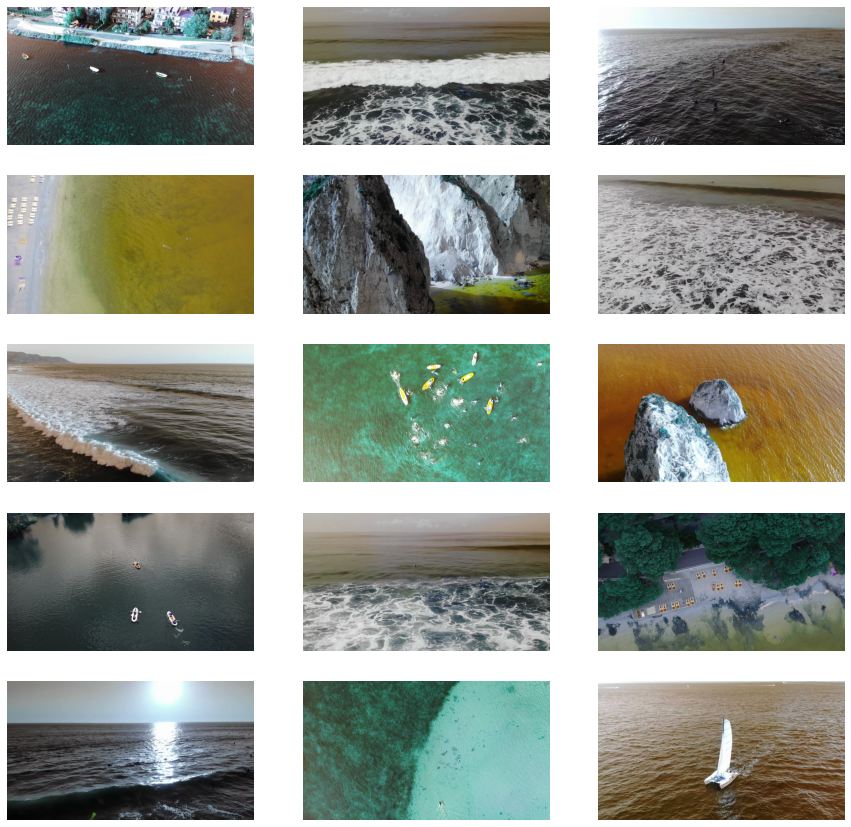

In [9]:
plt.figure(figsize=(15,15))
for i in range(15):
    plt.subplot(5,3,i+1)
    plt.imshow(plot_img_data[i])
    plt.axis('off')

In [10]:
import random
# Fuction to get images and their corresponding annotations
def loadImgAnn(img_path, ann_path, num):
    # return array of images
    imgList = os.listdir(img_path)
    annList = os.listdir(ann_path)
    #create lists to hold our values
    loadedImages = []
    loadedAnn = []
    #iterate a defined number of times
    for i in range(num):
        #select a random index within the our list length
        ind = random.randint(1,len(imgList))
        img = Image.open(img_path + '/' + imgList[ind])
        #As both images and annotations are named exactly, we get the annotations for each img
        file = os.path.basename(img_path + '/' + imgList[ind])
#         print(file)
        file_name = file[:-3] + 'txt' #replacing the extensions to txt from jpg on our filename
        with open((ann_path + '/' + file_name), 'r') as f:
            temp = [line for line in f.readlines()]
            loadedAnn.append(temp)
        loadedImages.append(img)
    return loadedImages, loadedAnn

In [11]:
loadedImgs, loadedAnnots = loadImgAnn(images_path, annot_path, 3)
print(len(loadedAnnots))
loadedAnnots[0]

3


['1 0.6677083333333333 0.12453703703703704 0.03958333333333333 0.12268518518518519\n',
 '0 0.6658854166666667 0.11898148148148148 0.02265625 0.04583333333333333\n',
 '0 0.6546875 0.01898148148148148 0.034375 0.062037037037037036\n',
 '1 0.5596354166666667 0.24166666666666667 0.029427083333333333 0.13842592592592592\n',
 '0 0.4942708333333333 0.1685185185185185 0.03515625 0.06666666666666667\n',
 '0 0.415625 0.11666666666666667 0.028385416666666666 0.04814814814814815\n',
 '0 0.40859375 0.1439814814814815 0.03359375 0.06620370370370371\n',
 '0 0.3841145833333333 0.26805555555555555 0.03177083333333333 0.04027777777777778\n',
 '0 0.38359375 0.34814814814814815 0.03411458333333333 0.04027777777777778\n',
 '0 0.48385416666666664 0.37037037037037035 0.040625 0.07962962962962963\n',
 '0 0.4817708333333333 0.4162037037037037 0.025260416666666667 0.05185185185185185\n',
 '0 0.47760416666666666 0.6050925925925926 0.030989583333333334 0.04259259259259259\n',
 '0 0.47317708333333336 0.75787037037

In [12]:
# Function to transform the values in our annotations to a float datatype
def floatannot(AnnList):
    coords = []
    float_coords = []
    #Go through our annotation list and scrape all our values into individul lists
    for i in AnnList:
        temp = []
        for ii in i:
            temp.append(ii.split())
        #Append list values to coord list
        coords.append(temp)
    #open coord list
    for i in coords:
        fltemp = []
        for ii in i:
            #Check if val is empty
            if len(ii) >0:
                #convert to float value
                z = [float(iii) for iii in ii]
                fltemp.append(z)
        float_coords.append(fltemp)
    return float_coords

In [13]:
annot_coords = floatannot(loadedAnnots)
annot_coords[0]

[[1.0,
  0.6677083333333333,
  0.12453703703703704,
  0.03958333333333333,
  0.12268518518518519],
 [0.0,
  0.6658854166666667,
  0.11898148148148148,
  0.02265625,
  0.04583333333333333],
 [0.0, 0.6546875, 0.01898148148148148, 0.034375, 0.062037037037037036],
 [1.0,
  0.5596354166666667,
  0.24166666666666667,
  0.029427083333333333,
  0.13842592592592592],
 [0.0,
  0.4942708333333333,
  0.1685185185185185,
  0.03515625,
  0.06666666666666667],
 [0.0,
  0.415625,
  0.11666666666666667,
  0.028385416666666666,
  0.04814814814814815],
 [0.0, 0.40859375, 0.1439814814814815, 0.03359375, 0.06620370370370371],
 [0.0,
  0.3841145833333333,
  0.26805555555555555,
  0.03177083333333333,
  0.04027777777777778],
 [0.0,
  0.38359375,
  0.34814814814814815,
  0.03411458333333333,
  0.04027777777777778],
 [0.0,
  0.48385416666666664,
  0.37037037037037035,
  0.040625,
  0.07962962962962963],
 [0.0,
  0.4817708333333333,
  0.4162037037037037,
  0.025260416666666667,
  0.05185185185185185],
 [0.0,
  

In [14]:
# Get image coordinates to be plotted on our images
#convert yolo annotations to image coordinates for bounding boxes
def img_coords(coords, img):
    img_size = img.size
    img_width = img_size[0]
    img_height = img_size[1]
    
    x1 = float(img_width) * (2.0 * float(coords[1]) - float(coords[3])) / 2.0
    y1 = float(img_height) * (2.0 * float(coords[2]) - float(coords[4])) / 2.0
    x2 = float(img_width) * (2.0 * float(coords[1]) + float(coords[3])) / 2.0
    y2 = float(img_height) * (2.0 * float(coords[2]) + float(coords[4])) / 2.0
    
    return [int(x1), int(y1), int(x2), int(y2)]  

In [15]:
coords_list = []
for i in range(3):
    temp = []
    img = loadedImgs[i]
    for ii in annot_coords[i]:
        z = img_coords(ii, img)
        temp.append(z)
    coords_list.append(temp)
coords_list[0]

[[2488, 136, 2640, 401],
 [2513, 207, 2600, 306],
 [2448, -26, 2580, 108],
 [2092, 372, 2205, 671],
 [1830, 292, 1965, 435],
 [1541, 200, 1650, 304],
 [1504, 239, 1633, 382],
 [1414, 535, 1535, 622],
 [1407, 708, 1538, 795],
 [1779, 714, 1936, 885],
 [1801, 843, 1898, 954],
 [1774, 1261, 1893, 1353],
 [1744, 1594, 1889, 1679],
 [1380, 1383, 1539, 1490],
 [1368, 1487, 1482, 1594],
 [1367, 1241, 1474, 1335],
 [1079, 1159, 1206, 1300],
 [1173, 1304, 1298, 1416],
 [1098, 1512, 1240, 1652],
 [1438, 1323, 1518, 1403]]

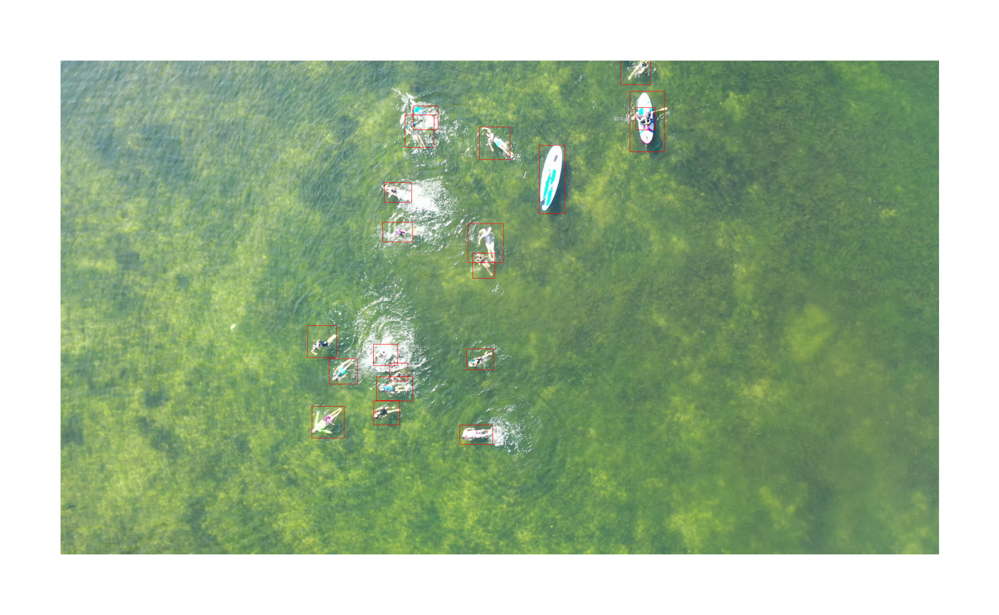

In [16]:
def draw_annot(img, annotList):
#     npimg = np.array(img)
#     cvImage = cv2.cvtColor(npimg, cv2.COLOR_RGB2BGR)
    img_copy = img.copy()
    for annot in annotList:
        drawImg = ImageDraw.Draw(img_copy)
        drawImg.rectangle(annot, outline=(255, 0, 0), width=2)
#         cv2.rectangle(cvImage, (annot[0], annot[1]), (annot[2], annot[3]), (255,0,0), 2)
    plt.imshow(img_copy)
    plt.axis('off')
    
# plt.figure(figsize=(15,15))
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[0], coords_list[0])

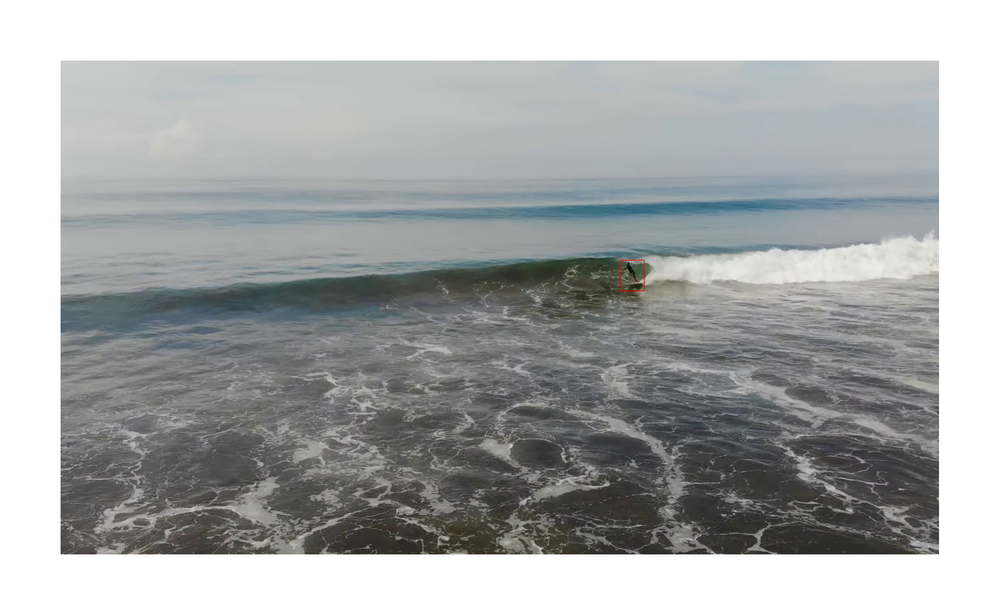

In [17]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[1], coords_list[1])

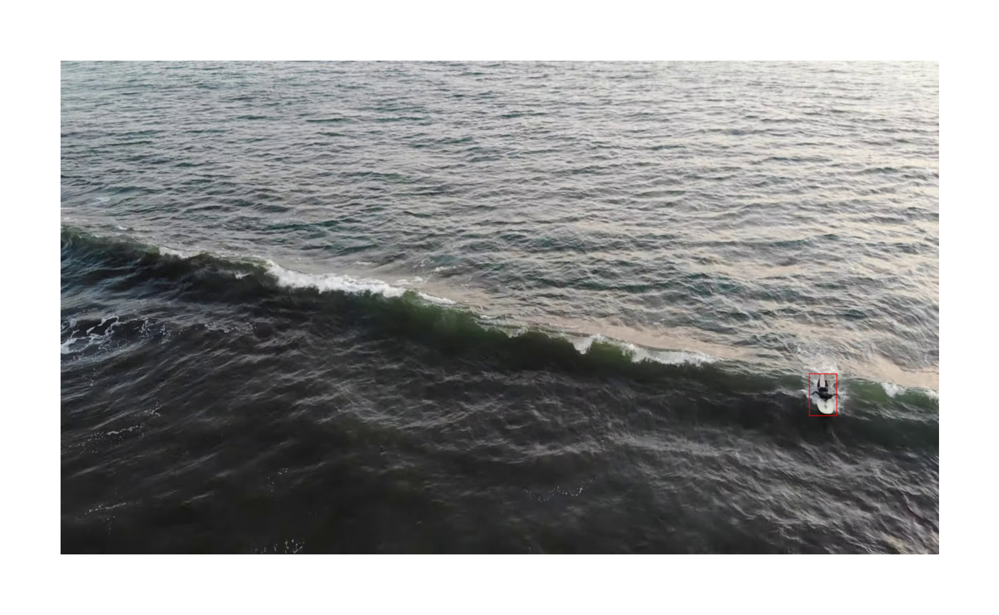

In [18]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
draw_annot(loadedImgs[2], coords_list[2])

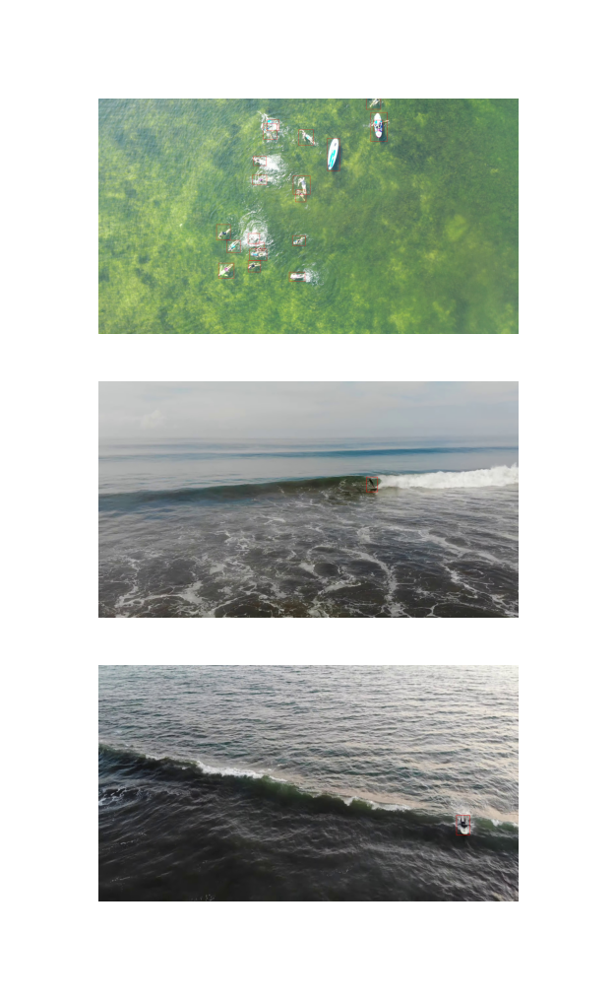

In [19]:
plt.figure(figsize=(1.920,1.080), dpi=1000)
for i in range(3):
    plt.subplot(3,1,i+1)
    draw_annot(loadedImgs[i], coords_list[i])

**Split Data into Train, Test & Validation**

In the first version of our notebook, we trained on image size of 640px, although this was a very good start, I noticed a low mAP at our smallest object which was humans, achieving an mAP of lower than 0.3. In our version 2, We increased our images at 1280px size, this resolution resulted in our mAP for humans rising to above 0.3 and lower than 0.4. For our third version, we will use tiled images to train and validate our model and we will also use a tiled inference technique on our test data.

In [20]:
#Creating our data paths
TRAIN_DIR = Path( '/kaggle/working/Data/images/' + 'train')
if not TRAIN_DIR.exists():
    print(f"Path {TRAIN_DIR} does not exit")
    os.makedirs(TRAIN_DIR)
TRAINANN_DIR = Path( '/kaggle/working/Data/labels/' + 'train')
if not TRAINANN_DIR.exists():
    print(f"Path {TRAINANN_DIR} does not exit")
    os.makedirs(TRAINANN_DIR)
    
    
TEST_DIR = Path( '/kaggle/working/Data/images/' + 'test')
if not TEST_DIR.exists():
    print(f"Path {TEST_DIR} does not exit")
    os.makedirs(TEST_DIR)
TESTANN_DIR = Path( '/kaggle/working/Data/labels/' + 'test')
if not TESTANN_DIR.exists():
    print(f"Path {TESTANN_DIR} does not exit")
    os.makedirs(TESTANN_DIR)

VAL_DIR = Path( '/kaggle/working/Data/images/' + 'val')
if not VAL_DIR.exists():
    print(f"Path {VAL_DIR} does not exit")
    os.makedirs(VAL_DIR)
VALANN_DIR = Path( '/kaggle/working/Data/labels/' + 'val')
if not VALANN_DIR.exists():
    print(f"Path {VALANN_DIR} does not exit")
    os.makedirs(VALANN_DIR)

Path /kaggle/working/Data/images/train does not exit
Path /kaggle/working/Data/labels/train does not exit
Path /kaggle/working/Data/images/test does not exit
Path /kaggle/working/Data/labels/test does not exit
Path /kaggle/working/Data/images/val does not exit
Path /kaggle/working/Data/labels/val does not exit


In [21]:
# !ls /kaggle/working/Data/images/

In [28]:
# Recall: 
# These have been then split into three parts: the training (67,4% of objects), the test (19,12% of objects), 
# and the validation set (13,48% of objects). In order to prevent overfitting of the model to the given data, 
# the test set contains selected frames from nine videos that were not used in either the training or validation sets.

# Fuction to split our image 
def split_data(file_list, img_path, ann_path, mode):
    #Check if we have our mode folders
    root_file = Path( '/kaggle/working/Data/images/'+  mode)
    if not root_file.exists():
        print(f"Path {root_file} does not exit")
        os.makedirs(root_file)

    root_file = Path('/kaggle/working/Data/labels/' + mode)
    if not root_file.exists():
        print(f"Path {root_file} does not exit")
        os.makedirs(root_file)
        
    #Creates the name of our label file from the img name and creates our source file
    for file in file_list:               
        name = file.replace('.jpg', '')        
        img_src_file = img_path + '/' + name + '.jpg'        
        annot_src_file = ann_path + '/' + name + '.txt'
        
        #move image
        IMG_DIR = '/kaggle/working/Data/images/' + mode
        img_dest_file = IMG_DIR + '/' + name + '.jpg'
        if os.path.isfile(img_src_file):
            shutil.move(img_src_file, img_dest_file)
            
        # Copy annotations
        ANNOT_DIR = '/kaggle/working/Data/labels/' + mode
        annot_dest_file = ANNOT_DIR + '/' + name + '.txt'
        if os.path.isfile(annot_src_file):
            shutil.move(annot_src_file, annot_dest_file)
        
    print("task successfully completed")

In [23]:
# Code taken from https://binginagesh.medium.com/small-object-detection-an-image-tiling-based-approach-bce572d890ca
# Code was tweaked to suit our problems

#Function to tile our chosen images
def tiler(imnames, imgnewpath, labelnewpath, falsepath, slice_size, ext, srcimg, srclabel):
    '''
    This function converts images into 
    blocks of slice_size x slice_size
    '''
    
    for imname in imnames:
        im = cv2.imread(srcimg + '/' + imname)
        height, width, _ = im.shape
        h_new = math.ceil(height/slice_size) * slice_size
        w_new = math.ceil(width/slice_size) * slice_size
        im = cv2.resize(im, (w_new, h_new), cv2.INTER_LINEAR)
        labname = imname.replace(ext, '.txt')
        labels = pd.read_csv((srclabel + '/' + labname), sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
        
        # we need to rescale coordinates from 0-1 to real image height and width
        labels[['x1', 'w']] = labels[['x1', 'w']] * w_new
        labels[['y1', 'h']] = labels[['y1', 'h']] * h_new
        
        boxes = []
        
        # convert bounding boxes to shapely polygons. We need to invert Y and find polygon vertices from center points
        for row in labels.iterrows():
            x1 = row[1]['x1'] - row[1]['w']/2
            y1 = (h_new - row[1]['y1']) - row[1]['h']/2
            x2 = row[1]['x1'] + row[1]['w']/2
            y2 = (h_new - row[1]['y1']) + row[1]['h']/2

            boxes.append((int(row[1]['class']), Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])))
        
        # create tiles and find intersection with bounding boxes for each tile
        for i in range((h_new // slice_size)):
            for j in range((w_new // slice_size)):
                x1 = j*slice_size
                y1 = h_new - (i*slice_size)
                x2 = ((j+1)*slice_size) - 1
                y2 = (h_new - (i+1)*slice_size) + 1

                pol = Polygon([(x1, y1), (x2, y1), (x2, y2), (x1, y2)])
                imsaved = False
                slice_labels = []

                for box in boxes:
                    if pol.intersects(box[1]):
                        inter = pol.intersection(box[1])        
                        if not imsaved:
                            sliced_im = im[i*slice_size:(i+1)*slice_size, j*slice_size:(j+1)*slice_size]
                            filename = imname.split('/')[-1]
#                             print(filename.replace(ext, f'_{i}_{j}{ext}'))
                            slice_path = imgnewpath + "/" + filename.replace(ext, f'_{i}_{j}{ext}')                            
                            slice_labels_path = labelnewpath + "/" + filename.replace(ext, f'_{i}_{j}.txt')                            
                            #print(slice_path)
                            cv2.imwrite(slice_path,sliced_im)
#                             sliced_im.save(slice_path)
                            imsaved = True                    
                        
                        # get smallest rectangular polygon (with sides parallel to the coordinate axes) that contains the intersection
                        new_box = inter.envelope 
                        
                        # get central point for the new bounding box 
                        centre = new_box.centroid
                        
                        # get coordinates of polygon vertices
                        x, y = new_box.exterior.coords.xy
                        
                        # get bounding box width and height normalized to slice size
                        new_width = (max(x) - min(x)) / slice_size
                        new_height = (max(y) - min(y)) / slice_size
                        
                        # we have to normalize central x and invert y for yolo format
                        new_x = (centre.coords.xy[0][0] - x1) / slice_size
                        new_y = (y1 - centre.coords.xy[1][0]) / slice_size
                        slice_labels.append([box[0], new_x, new_y, new_width, new_height])
                
                if len(slice_labels) > 0:
                    slice_df = pd.DataFrame(slice_labels, columns=['class', 'x1', 'y1', 'w', 'h'])
                    #print(slice_df)
                    slice_df.to_csv(slice_labels_path, sep=' ', index=False, header=False, float_format='%.6f')
                
                if not imsaved and falsepath:
                    sliced_im = im[i*slice_size:(i+1)*slice_size, j*slice_size:(j+1)*slice_size]
                    filename = imname.split('/')[-1]
                    slice_path = falsepath + "/" + filename.replace(ext, f'_{i}_{j}{ext}')                
                    sliced_im.save(slice_path)
                    imsaved = True
    
    print("tiling successfully completed")

In [24]:
#Get our images list
train_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/train.txt'
test_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/test.txt'
val_imgs = '/kaggle/input/afo-aerial-dataset-of-floating-objects/PART_1/PART_1/validation.txt'
with open(train_imgs, 'r') as f:
    train_img_list = [line.strip() for line in f.readlines()]
    
with open(test_imgs, 'r') as f:
    test_img_list = [line.strip() for line in f.readlines()]
    
with open(val_imgs, 'r') as f:
    val_img_list = [line.strip() for line in f.readlines()]

# print(train_img_list[0], test_img_list[0], val_img_list[0])

In [29]:
#Split Data
split_data(test_img_list, images_path, annot_path, 'test')

task successfully completed


In [31]:
# !ls /kaggle/working/Data/labels/test/

In [ ]:
ext = ".jpg"
size = 512
Train_path = '/kaggle/working/Data/images/train'
TrainAnn_path = '/kaggle/working/Data/labels/train'
Val_path = '/kaggle/working/Data/images/val'
ValAnn_path = '/kaggle/working/Data/labels/val'
images_path = '/kaggle/working/Dataset/images'
annot_path = '/kaggle/working/Dataset/annotations'

tiler(train_img_list, Train_path, TrainAnn_path, None, size, ext, images_path, annot_path)
tiler(train_img_list, Val_path, ValAnn_path, None, size, ext, images_path, annot_path)

In [ ]:
!ls /kaggle/working/Data
!ls /kaggle/working/Data/images
!ls /kaggle/working/Data/labels

In [ ]:
!ls /kaggle/working/Data/images/train/

In [ ]:
imname = 'a_1014_0_4'
im = Image.open(f'/kaggle/working/Data/images/train/{imname}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/train/{imname}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(10,10))
# display the image
ax.imshow(imr)
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
    
plt.show()

In [ ]:
imname = 'b1_241_2_3'
im = Image.open(f'/kaggle/working/Data/images/train/{imname}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/train/{imname}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(10,10))
# display the image
ax.imshow(imr)
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
    
plt.show()

In [ ]:
imname3 = 'k4_178_1_3'
im = Image.open(f'/kaggle/working/Data/images/train/{imname3}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/train/{imname3}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(10,10))
# display the image
ax.imshow(imr)
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
    
plt.show()

**Model Training and Preparation**

For our model building, we will be using the ultralytics YoloV5 medium model. We will also be freezing some layers in our model to futher fine tune our model building process.

In [32]:
# Download our Yolov5 model
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 14887, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 14887 (delta 0), reused 0 (delta 0), pack-reused 14882
Receiving objects: 100% (14887/14887), 13.86 MiB | 29.08 MiB/s, done.
Resolving deltas: 100% (10246/10246), done.


In [ ]:
%cd yolov5
!ls

In [ ]:
#Creating a Yaml file for our yolov5 model
import yaml

dict_file = {'train':'/kaggle/working/Data/images/train' ,
            'val': '/kaggle/working/Data/images/val',
            'nc' : '6',
            'names' : ['human', 'wind/sup-board', 'boat', 'bouy', 'sailboat', 'kayak']
            }

with open('/kaggle/working/yolov5/data/AFO.yaml', 'w+') as file:
    documents = yaml.dump(dict_file, file)

In [ ]:
!ls

In [ ]:
!ls data

In [ ]:
# Disable weight and biases
!wandb disabled

In [ ]:
# YOLOv5 Model training with Layer Freezing
!python train.py --data data/AFO.yaml --weights /kaggle/input/pretrained-model/best.pt --img 512 --epochs 5 --batch-size 64 

In [ ]:
!python train.py --data data/AFO.yaml --weights runs/train/exp/weights/best.pt --img 512 --epochs 10 --batch-size 64

In [ ]:
# %cd yolov5

In [ ]:
!python train.py --resume

In [ ]:
!ls
print('')
!ls runs/train/exp2/weights

In [ ]:
# Image.open('runs/train/exp2/labels.jpg')

In [ ]:
Image.open('runs/train/exp2/results.png')

In [ ]:
!python train.py --data data/AFO.yaml --weights runs/train/exp2/weights/best.pt --img 512 --epochs 10 --batch-size 64 --freeze 10

In [ ]:
!python train.py --data data/AFO.yaml --weights runs/train/exp3/weights/best.pt --img 512 --epochs 10 --batch-size 64 --freeze 24

In [ ]:
!python train.py --data data/AFO.yaml --weights runs/train/exp4/weights/best.pt --img 512 --epochs 5 --batch-size 64 --freeze 20

**Model Inference with SAHI**

In [ ]:
!pip install -U sahi

In [ ]:
!pip install -U yolov5

In [35]:
os.getcwd()

'/kaggle/working'

In [37]:
# arrange an instance segmentation model for test
# import required functions, classes
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image_as_pil
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [42]:
!sahi predict --source /kaggle/working/Data/images/test --model_type yolov5 --model_path /kaggle/input/fiinalmodel/best.pt --slice_height 512 --slice_width 512

There are 514 listed files in folder: test/
Performing prediction on 24 number of slices.                                   
Prediction time is: 668.59 ms                                                   
Performing prediction on 60 number of slices.                                   
Prediction time is: 1451.16 ms                                                  
Performing prediction on 24 number of slices.                                   
Prediction time is: 580.41 ms                                                   
Performing prediction on 60 number of slices.                                   
Prediction time is: 1858.07 ms                                                  
Performing prediction on 60 number of slices.                                   
Prediction time is: 1477.28 ms                                                  
Performing prediction on 24 number of slices.                                   
Prediction time is: 590.99 ms                                    

In [61]:
!ls Data/images/test

a_301.jpg  a_387.jpg	c_120.jpg    iv_272.jpg  k5_35.jpg   r4_31.jpg
a_302.jpg  a_388.jpg	c_121.jpg    iv_277.jpg  k5_36.jpg   r4_32.jpg
a_303.jpg  a_389.jpg	c_122.jpg    iv_282.jpg  k5_37.jpg   r4_33.jpg
a_304.jpg  a_390.jpg	c_123.jpg    j1_151.jpg  k5_38.jpg   r4_34.jpg
a_305.jpg  a_391.jpg	c_124.jpg    j1_152.jpg  k5_39.jpg   r4_35.jpg
a_306.jpg  a_392.jpg	c_125.jpg    j1_153.jpg  k5_4.jpg    r4_36.jpg
a_307.jpg  a_393.jpg	c_126.jpg    j1_154.jpg  k5_40.jpg   r4_37.jpg
a_308.jpg  a_394.jpg	c_127.jpg    j1_155.jpg  k5_43.jpg   r4_39.jpg
a_309.jpg  a_395.jpg	c_128.jpg    j1_156.jpg  k5_45.jpg   r4_4.jpg
a_310.jpg  a_396.jpg	c_129.jpg    j1_157.jpg  k5_47.jpg   r4_42.jpg
a_311.jpg  a_397.jpg	c_130.jpg    j1_158.jpg  k5_49.jpg   r4_43.jpg
a_312.jpg  a_398.jpg	c_131.jpg    j1_159.jpg  k5_5.jpg    r4_45.jpg
a_313.jpg  a_399.jpg	c_132.jpg    j1_160.jpg  k5_50.jpg   r4_48.jpg
a_314.jpg  a_400.jpg	c_133.jpg    j1_161.jpg  k5_54.jpg   r4_5.jpg
a_315.jpg  a_401.jpg	c_134.jpg    j1_162.jpg  k5_5

In [49]:
!ls runs/predict/exp3/visuals/

a_301.png  a_387.png	c_120.png    iv_272.png  k5_35.png   r4_31.png
a_302.png  a_388.png	c_121.png    iv_277.png  k5_36.png   r4_32.png
a_303.png  a_389.png	c_122.png    iv_282.png  k5_37.png   r4_33.png
a_304.png  a_390.png	c_123.png    j1_151.png  k5_38.png   r4_34.png
a_305.png  a_391.png	c_124.png    j1_152.png  k5_39.png   r4_35.png
a_306.png  a_392.png	c_125.png    j1_153.png  k5_4.png    r4_36.png
a_307.png  a_393.png	c_126.png    j1_154.png  k5_40.png   r4_37.png
a_308.png  a_394.png	c_127.png    j1_155.png  k5_43.png   r4_39.png
a_309.png  a_395.png	c_128.png    j1_156.png  k5_45.png   r4_4.png
a_310.png  a_396.png	c_129.png    j1_157.png  k5_47.png   r4_42.png
a_311.png  a_397.png	c_130.png    j1_158.png  k5_49.png   r4_43.png
a_312.png  a_398.png	c_131.png    j1_159.png  k5_5.png    r4_45.png
a_313.png  a_399.png	c_132.png    j1_160.png  k5_50.png   r4_48.png
a_314.png  a_400.png	c_133.png    j1_161.png  k5_54.png   r4_5.png
a_315.png  a_401.png	c_134.png    j1_162.png  k5_5

(-0.5, 3839.5, 2159.5, -0.5)

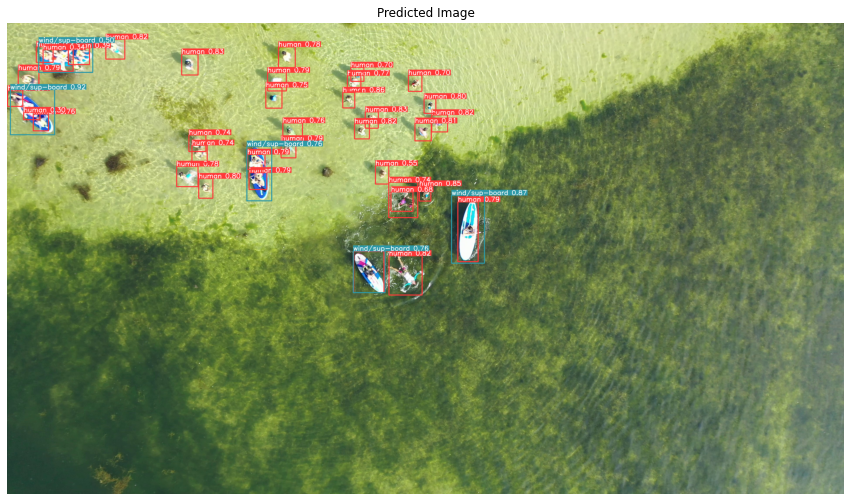

In [72]:
img = Image.open('/kaggle/working/runs/predict/exp3/visuals/a_301.png') 
plt.figure(figsize=(15,15))
plt.imshow(img)
plt.title('Predicted Image')
plt.axis('off')

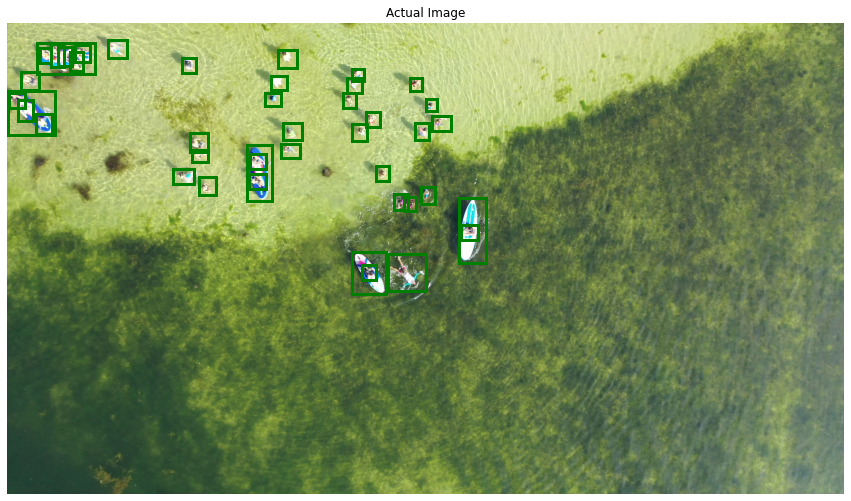

In [73]:
# img = Image.open('/kaggle/working/Data/images/test/a_301.jpg')
# plt.figure(figsize=(1.920,1.080), dpi=1000)
imname = 'a_301'
im = Image.open(f'/kaggle/working/Data/images/test/{imname}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/test/{imname}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(15,15))
# display the image
ax.imshow(imr)
ax.set_title('Actual Image')
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
plt.axis('off')    
plt.show()

(-0.5, 3839.5, 2159.5, -0.5)

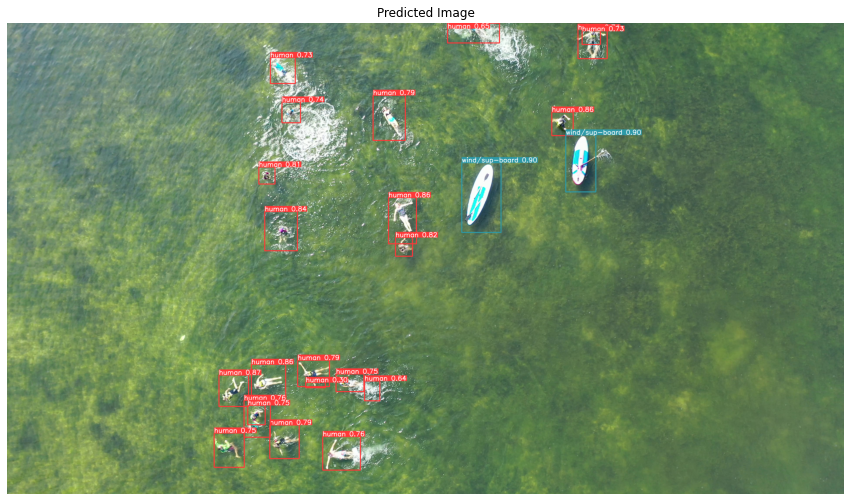

In [74]:
img2 = Image.open('/kaggle/working/runs/predict/exp3/visuals/c_129.png') 
plt.figure(figsize=(15,15))
plt.imshow(img2)
plt.title('Predicted Image')
plt.axis('off')

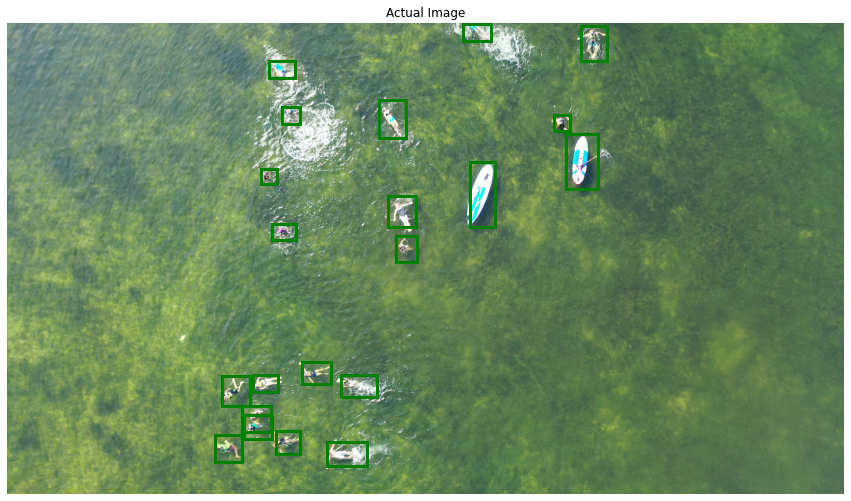

In [75]:
imname2 = 'c_129'
im = Image.open(f'/kaggle/working/Data/images/test/{imname2}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/test/{imname2}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(15,15))
# display the image
ax.imshow(imr)
ax.set_title('Actual Image')
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
plt.axis('off')    
plt.show()

(-0.5, 2719.5, 1529.5, -0.5)

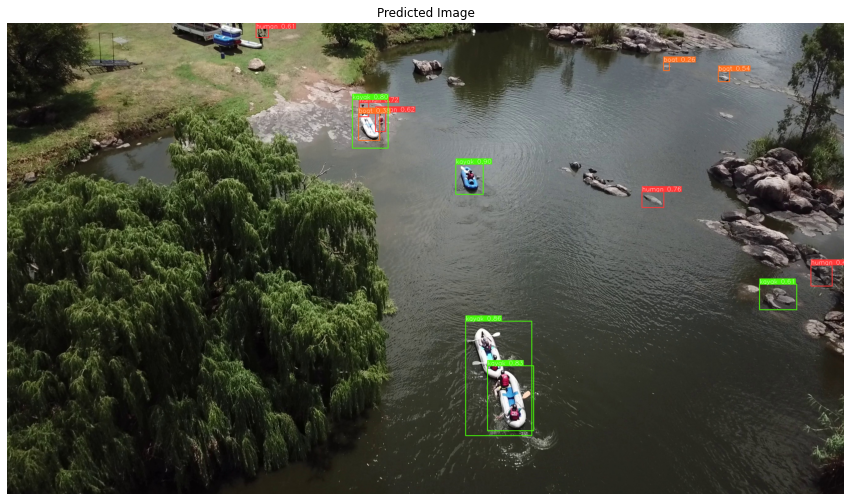

In [76]:
img3 = Image.open('/kaggle/working/runs/predict/exp3/visuals/r4_42.png') 
plt.figure(figsize=(15,15))
plt.imshow(img3)
plt.title('Predicted Image')
plt.axis('off')

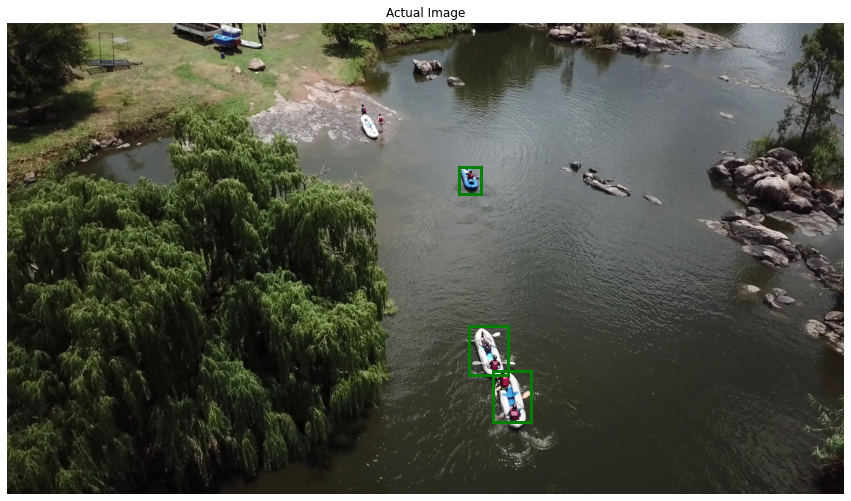

In [77]:
imname3 = 'r4_42'
im = Image.open(f'/kaggle/working/Data/images/test/{imname3}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/test/{imname3}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(15,15))
# display the image
ax.imshow(imr)
ax.set_title('Actual Image')
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
plt.axis('off')    
plt.show()

(-0.5, 2559.5, 1439.5, -0.5)

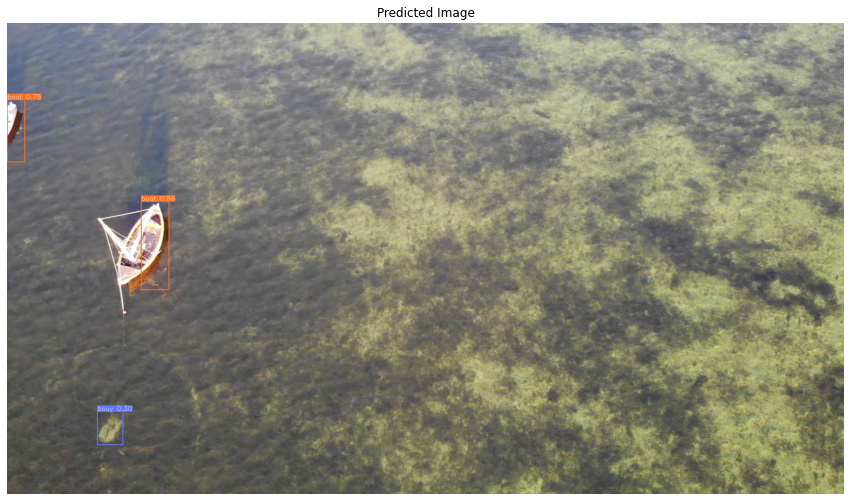

In [78]:
img4 = Image.open('/kaggle/working/runs/predict/exp3/visuals/j1_158.png') 
plt.figure(figsize=(15,15))
plt.imshow(img4)
plt.title('Predicted Image')
plt.axis('off')

/opt/conda/lib/python3.7/site-packages/pandas/core/frame.py:3641: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


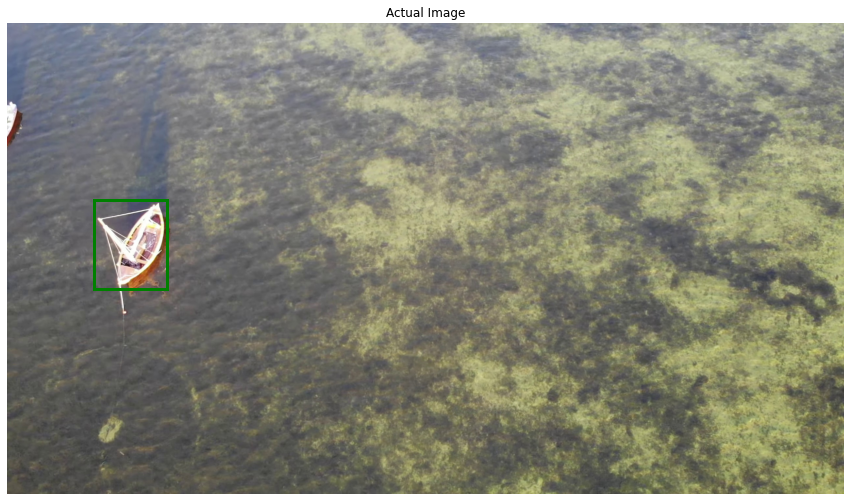

In [79]:
imname4 = 'j1_158'
im = Image.open(f'/kaggle/working/Data/images/test/{imname4}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/test/{imname4}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(15,15))
# display the image
ax.imshow(imr)
ax.set_title('Actual Image')
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
plt.axis('off')    
plt.show()

(-0.5, 2559.5, 1439.5, -0.5)

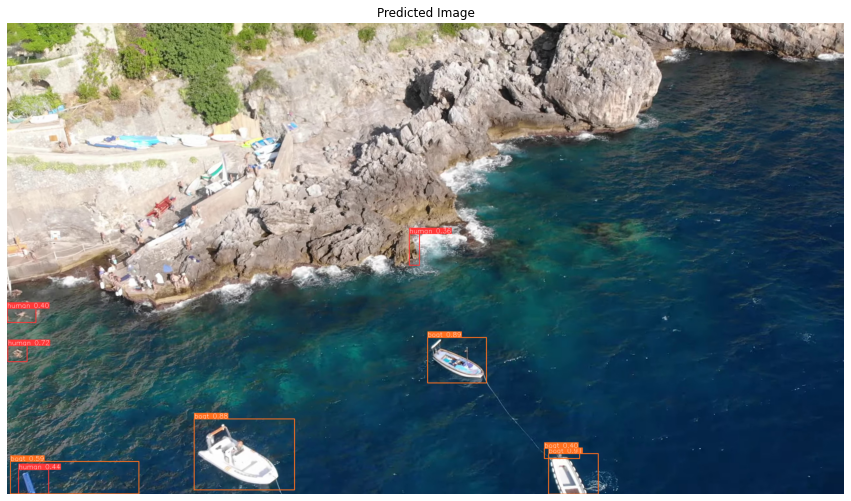

In [80]:
img5 = Image.open('/kaggle/working/runs/predict/exp3/visuals/iv_118.png') 
plt.figure(figsize=(15,15))
plt.imshow(img5)
plt.title('Predicted Image')
plt.axis('off')

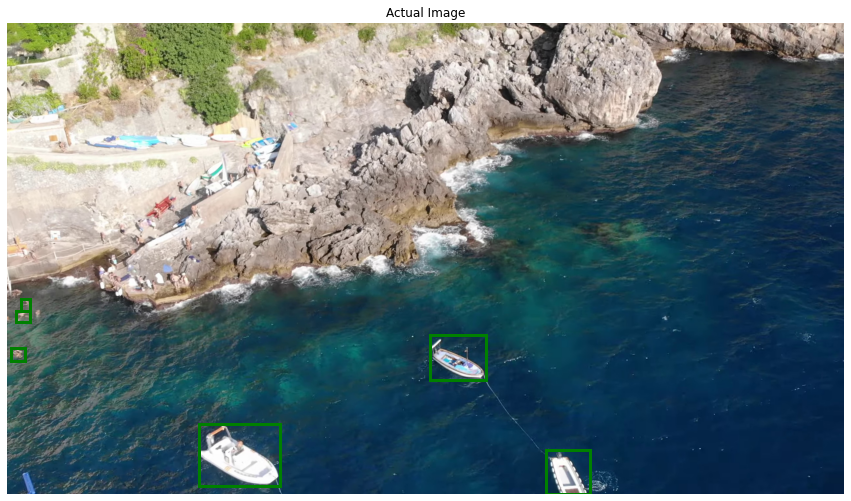

In [81]:
imname5 = 'iv_118'
im = Image.open(f'/kaggle/working/Data/images/test/{imname5}.jpg')
df = pd.read_csv(f'/kaggle/working/Data/labels/test/{imname5}.txt', sep=' ', names=['class', 'x1', 'y1', 'w', 'h'])
imr = np.array(im, dtype=np.uint8)

# rescale coordinates for visualization
df_scaled = df.iloc[:, 1:]
df_scaled[['x1', 'w']] = df_scaled[['x1', 'w']] * imr.shape[1]
df_scaled[['y1', 'h']] = df_scaled[['y1', 'h']] * imr.shape[0]
# create figure and axes
fig,ax = plt.subplots(1, figsize=(15,15))
# display the image
ax.imshow(imr)
ax.set_title('Actual Image')
for box in df_scaled.values:
    # create a Rectangle patch
    rect = patches.Rectangle((box[0]-(box[2]/2),box[1]-(box[3]/2)),box[2],box[3],linewidth=3,edgecolor='g',facecolor='none')
# add the patch to the axes
    ax.add_patch(rect)
plt.axis('off')    
plt.show()

In [ ]:
# model_type = "yolov5"
# model_path = yolov5_model_path
# model_device = "cpu" # or 'cuda:0'
# model_confidence_threshold = 0.4

# slice_height = 256
# slice_width = 256
# overlap_height_ratio = 0.2
# overlap_width_ratio = 0.2

# source_image_dir = "demo_data/"

In [ ]:
# predict(
#     model_type=model_type,
#     model_path=model_path,
#     model_device=model_device,
#     model_confidence_threshold=model_confidence_threshold,
#     source=source_image_dir,
#     slice_height=slice_height,
#     slice_width=slice_width,
#     overlap_height_ratio=overlap_height_ratio,
#     overlap_width_ratio=overlap_width_ratio,
# )

In [ ]:
# !python detect.py --img 1280 --source /kaggle/working/Dataset/images/test --weights runs/train/exp/weights/best.pt --conf-thres 0.2

All in all our model performs really well compared to the number of epochs run, we can also notice the model is susceptible to small objects which is as a result of the inference method used.
For futher improvement i will recommend more epochs to train our model

In [ ]:
# %cd /kaggle/working/

In [87]:
# !ls yolov5/models

__init__.py  experimental.py  segment  yolo.py	     yolov5m.yaml  yolov5s.yaml
common.py    hub	      tf.py    yolov5l.yaml  yolov5n.yaml  yolov5x.yaml


In [ ]:
# !zip -r trainexps.zip !ls runs/predict/exp3/visuals/